In [1]:
import cv2
import numpy as np
import os
import glob
import matplotlib.pyplot as plt

In [2]:
import zipfile
import shutil
import datetime

In [3]:
zip_file_path = 'dataset.zip'
extract_path = './'

In [4]:
# Check if the ZIP file exists
if os.path.exists(zip_file_path):
    # Check if a 'dataset' folder already exists
    dataset_folder = os.path.join(extract_path, 'dataset')
    if os.path.exists(dataset_folder):
        # Rename the existing 'dataset' folder with a timestamp
        timestamp = datetime.datetime.now().strftime("%Y%m%d%H%M%S")
        new_dataset_folder_name = f'auto_replaced_dataset_{timestamp}'
        os.rename(dataset_folder, os.path.join(extract_path, new_dataset_folder_name))
        print(f"Existing 'dataset' folder renamed to '{new_dataset_folder_name}'.")

    # Extract the ZIP file to the root directory
    with zipfile.ZipFile(zip_file_path, 'r') as zip_ref:
        zip_ref.extractall(extract_path)

    print("The contents of 'dataset.zip' have been extracted to the 'dataset' folder.")
else:
    print("No 'dataset.zip' file present to extract.")

The contents of 'dataset.zip' have been extracted to the 'dataset' folder.


In [5]:
# Paths to the dataset folders
train_image_folder = "./dataset/images/class1/"
train_mask_folder = "./dataset/masks/class1/"
validate_image_folder = "./dataset/validate/images/class1/"
validate_mask_folder = "./dataset/validate/masks/"
# print(train_image_folder)

./dataset/images/class1/


In [6]:
# Load the file names
train_images = glob.glob(train_image_folder + "*.jpg")
train_masks = glob.glob(train_mask_folder + "*.png")
validate_images = glob.glob(validate_image_folder + "*.jpg")
validate_masks = glob.glob(validate_mask_folder + "*.png")

print(train_images)

['./dataset/images/class1\\104_sat.jpg', './dataset/images/class1\\113_sat.jpg', './dataset/images/class1\\343_sat.jpg', './dataset/images/class1\\388_sat.jpg', './dataset/images/class1\\541_sat.jpg', './dataset/images/class1\\562_sat.jpg', './dataset/images/class1\\602_sat.jpg', './dataset/images/class1\\627_sat.jpg', './dataset/images/class1\\655_sat.jpg', './dataset/images/class1\\951_sat.jpg']


In [7]:
train_images = sorted(glob.glob(train_image_folder + "*.jpg"))
train_masks = sorted(glob.glob(train_mask_folder + "*.png"))
validate_images = sorted(glob.glob(validate_image_folder + "*.jpg"))
validate_masks = sorted(glob.glob(validate_mask_folder + "*.png"))

In [8]:
# Image Preprocessing
def preprocess_image(input_data):
    """
    This function takes the path of an image or an image and returns the preprocessed image.
    Preprocessing steps include converting to HSV color space and applying Gaussian blurring.
    """
    # print(input_data)
    # Read the image
    if isinstance(input_data, str):
        # If input is a file path, read the image
        image = cv2.imread(input_data)
    else:
        # If input is an array, use it directly
        image = input_data

    # Convert to HSV color space
    hsv_image = cv2.cvtColor(image, cv2.COLOR_BGR2HSV)

    # Apply Gaussian blurring to reduce noise and improve edge detection
    # NOTE: Commented because we may not need this. Add it if the results get worse.
    # blurred_image = cv2.GaussianBlur(hsv_image, (5, 5), 0)

    # return blurred_image
    return hsv_image

In [9]:
def color_segmentation(image):
    mask = dynamic_color_segmentation(image)
    return mask

def dynamic_color_segmentation(input_image):
    hsv = cv2.cvtColor(input_image, cv2.COLOR_BGR2HSV)
    h_mean = np.mean(hsv[:,:,0])
    s_mean = np.mean(hsv[:,:,1])
    lower_bound = np.array([h_mean-10, s_mean-40, 40])
    upper_bound = np.array([h_mean+10, 255, 255])
    mask = cv2.inRange(hsv, lower_bound, upper_bound)
    return mask

In [10]:
def adaptive_color_segmentation(input_image):
    # Convert to HSV and get the Value channel for thresholding
    hsv = cv2.cvtColor(input_image, cv2.COLOR_BGR2HSV)
    value_channel = hsv[:, :, 2]
    
    # Use adaptive thresholding on the Value channel
    adaptive_thresh = cv2.adaptiveThreshold(
        value_channel, 255, cv2.ADAPTIVE_THRESH_GAUSSIAN_C, cv2.THRESH_BINARY_INV, blockSize=19, C=9
    )
    # You might want to perform additional morphological operations on the adaptive_thresh to clean it up
    
    return adaptive_thresh


In [11]:
def preprocess_image_for_edges(input_data):
    if isinstance(input_data, str):
        image = cv2.imread(input_data)
    else:
        image = input_data
    
    # Apply bilateral filter
    filtered_image = cv2.bilateralFilter(image, d=5, sigmaColor=50, sigmaSpace=50)
    
    return filtered_image
    
def edge_detection(image):
    # Convert to grayscale first
    gray_image = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
    # Apply Otsu's thresholding after Gaussian filtering
    blur = cv2.GaussianBlur(gray_image, (5, 5), 0)
    _, otsu_thresh = cv2.threshold(blur, 0, 255, cv2.THRESH_BINARY + cv2.THRESH_OTSU)
    
    # Use your hybrid edge detection on the Otsu thresholded image
    edges = hybrid_edge_detection(otsu_thresh)
    return edges

def hybrid_edge_detection(input_image):
    # Convert input image to grayscale (if not already) for edge detection methods
    if len(input_image.shape) > 2:
        gray_image = cv2.cvtColor(input_image, cv2.COLOR_BGR2GRAY)
    else:
        gray_image = input_image

    # Sobel edge detection
    edges_sobel_x = cv2.Sobel(gray_image, cv2.CV_64F, 1, 0, ksize=5)
    edges_sobel_y = cv2.Sobel(gray_image, cv2.CV_64F, 0, 1, ksize=5)
    edges_sobel = cv2.convertScaleAbs(cv2.magnitude(edges_sobel_x, edges_sobel_y))

    # Prewitt edge detection
    kernelx = np.array([[1, 1, 1], [0, 0, 0], [-1, -1, -1]])
    kernely = np.array([[-1, 0, 1], [-1, 0, 1], [-1, 0, 1]])
    edges_prewitt_x = cv2.filter2D(gray_image, -1, kernelx)
    edges_prewitt_y = cv2.filter2D(gray_image, -1, kernely)
    edges_prewitt = cv2.convertScaleAbs(cv2.addWeighted(edges_prewitt_x, 0.5, edges_prewitt_y, 0.5, 0))

    # Canny edge detection
    edges_canny = cv2.Canny(gray_image, 100, 200)

    # Combine all edge maps
    combined_edges = cv2.bitwise_or(edges_canny, cv2.bitwise_or(edges_sobel, edges_prewitt))

    return combined_edges



In [12]:
# Morphological Operations
def apply_morphology(image):
    """
    This function takes an image with edges detected and applies morphological operations.
    """
    kernel_size = 5
    kernel = np.ones((kernel_size, kernel_size), np.uint8)    # You might want to try different morphological operations such as opening first, then closing
    kernel = cv2.getStructuringElement(cv2.MORPH_RECT, (kernel_size, kernel_size))
    # opening = cv2.morphologyEx(image, cv2.MORPH_OPEN, kernel, iterations=1)
    closing = cv2.morphologyEx(image, cv2.MORPH_CLOSE, kernel, iterations=1)

    return closing

In [13]:

def find_contours(image):
    """
    This function takes an image with edges and morphological operations applied,
    then finds and returns contours.
    """
    contours, _ = cv2.findContours(image, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)

    # Filter out small contours based on area (Optional)
    # contours = [cnt for cnt in contours if cv2.contourArea(cnt) > 500]
    # Consider not filtering or setting an appropriate threshold
    appropriate_threshold = 150

    contours = [cnt for cnt in contours if cv2.contourArea(cnt) > appropriate_threshold]

    return contours

In [14]:
# Post-Processing
def create_mask(contours, shape):
    """
    This function takes detected contours and creates a mask.
    """
    mask = np.zeros(shape, np.uint8)
    cv2.drawContours(mask, contours, -1, (255, 255, 255), thickness=cv2.FILLED)
    # Apply Gaussian blur to smooth the mask
    # blurred_mask = cv2.GaussianBlur(mask, (5, 5), 0)
    # Apply Median filtering to reduce noise
    # smoothed_mask = cv2.medianBlur(mask, 5)
    # Use morphological closing to fill small holes
    kernel = np.ones((5,5), np.uint8)
    mask = cv2.morphologyEx(mask, cv2.MORPH_CLOSE, kernel)

    return mask

In [15]:
def post_process(image):
    kernel_size = 3
    kernel = np.ones((kernel_size, kernel_size), np.uint8)
    opening = cv2.morphologyEx(image, cv2.MORPH_OPEN, kernel)
    return opening

In [16]:
# IoU Calculation
def calculate_iou(predicted_mask, ground_truth_mask):
    """
    This function takes a predicted mask and a ground truth mask and returns the Intersection over Union (IoU) score.
    """
    # Calculate intersection and union
    intersection = np.logical_and(predicted_mask, ground_truth_mask)
    union = np.logical_or(predicted_mask, ground_truth_mask)

    iou_score = np.sum(intersection) / np.sum(union)
    return iou_score


In [17]:
def visualize_results(original_image, preprocessed_image_for_edges, edges, adaptive_mask, morphed_mask, mask, ground_truth_mask, iou_score):
    plt.figure(figsize=(20, 20))

    # Now let's plot 4 rows and 2 columns for the 7 images + 1 placeholder
    plt.subplot(4, 2, 1)
    plt.title("Original Image")
    plt.imshow(cv2.cvtColor(original_image, cv2.COLOR_BGR2RGB))
    plt.axis("off")

    plt.subplot(4, 2, 2)
    plt.title("Preprocessed image for edges")
    plt.imshow(preprocessed_image_for_edges, cmap="gray")
    plt.axis("off")

    plt.subplot(4, 2, 3)
    plt.title("Edges")
    plt.imshow(edges, cmap="gray")
    plt.axis("off")

    plt.subplot(4, 2, 4)
    plt.title("Adaptive Mask")
    plt.imshow(adaptive_mask, cmap="gray")
    plt.axis("off")

    plt.subplot(4, 2, 5)
    plt.title("Morphed Mask")
    plt.imshow(morphed_mask, cmap="gray")
    plt.axis("off")

    plt.subplot(4, 2, 6)
    plt.title(f"Segmented Mask - IoU: {iou_score:.2f}")
    plt.imshow(mask, cmap="gray")
    plt.axis("off")

    plt.subplot(4, 2, 7)
    plt.title("Ground Truth Mask")
    plt.imshow(ground_truth_mask, cmap="gray")
    plt.axis("off")

    # We have an empty spot since we have 7 images and 8 slots, you can leave it empty
    # or use it for additional information or another image.
    plt.subplot(4, 2, 8)
    plt.axis("off")

    plt.tight_layout()
    plt.show()


In [18]:
def debug_visualization(images, titles):
    num_images = len(images)
    plt.figure(figsize=(15, 5 * num_images))

    for i, (image, title) in enumerate(zip(images, titles)):
        plt.subplot(num_images, 1, i + 1)
        plt.title(title)
        if image.ndim == 2:  # Grayscale image
            plt.imshow(image, cmap='gray')
        elif image.shape[2] == 3:  # Color image
            plt.imshow(cv2.cvtColor(image, cv2.COLOR_BGR2RGB))
        plt.axis('off')
    plt.tight_layout()
    plt.show()


In [19]:
from sklearn.metrics import precision_score, recall_score, f1_score

def calculate_metrics(predicted_mask, ground_truth_mask):
    # Flatten the masks to compare element-wise
    predicted_flat = predicted_mask.flatten()
    ground_truth_flat = ground_truth_mask.flatten()

    # Binary thresholding may be necessary if the masks are not binary
    predicted_flat = (predicted_flat > 127).astype(np.uint8)
    ground_truth_flat = (ground_truth_flat > 127).astype(np.uint8)

    precision = precision_score(ground_truth_flat, predicted_flat)
    recall = recall_score(ground_truth_flat, predicted_flat)
    f1 = f1_score(ground_truth_flat, predicted_flat)

    return precision, recall, f1

In [20]:

def calculate_accuracy(predicted_mask, ground_truth_mask):
    correct = np.sum(predicted_mask == ground_truth_mask)
    total = ground_truth_mask.size
    accuracy = correct / total
    return accuracy

In [46]:
# def calculate_road_length(contours, pixel_to_real=None):
#     total_length = 0
#     for contour in contours:
#         # Approximate contour to a polyline
#         epsilon = 0.01 * cv2.arcLength(contour, True)
#         approx = cv2.approxPolyDP(contour, epsilon, True)

#         # Calculate the length of the polyline
#         segment_length = 0
#         for i in range(1, len(approx)):
#             point1 = approx[i - 1][0]
#             point2 = approx[i][0]
#             segment_length += np.linalg.norm(point2 - point1)

#         # Convert pixel length to real-world length if conversion factor provided
#         if pixel_to_real is not None:
#             segment_length *= pixel_to_real

#         total_length += segment_length

#     return total_length

In [65]:
def calculate_road_length(contours, pixel_to_real=None):
    total_length = 0
    road_contours = []  
    for contour in contours:
        # Approximate contour to a polyline
        epsilon = 0.01 * cv2.arcLength(contour, True)
        approx = cv2.approxPolyDP(contour, epsilon, True)
        road_contours.append(approx)  # Store the polyline

        # Calculate the length of the polyline
        segment_length = 0
        segment_length = np.sum([np.linalg.norm(approx[i][0] - approx[i - 1][0]) for i in range(1, len(approx))])

        for i in range(1, len(approx)):
            point1 = approx[i - 1][0]
            point2 = approx[i][0]
            segment_length += np.linalg.norm(point2 - point1)

        # Convert pixel length to real-world length if conversion factor provided
        if pixel_to_real is not None:
            segment_length *= pixel_to_real

        total_length += segment_length
        

    return total_length, road_contours

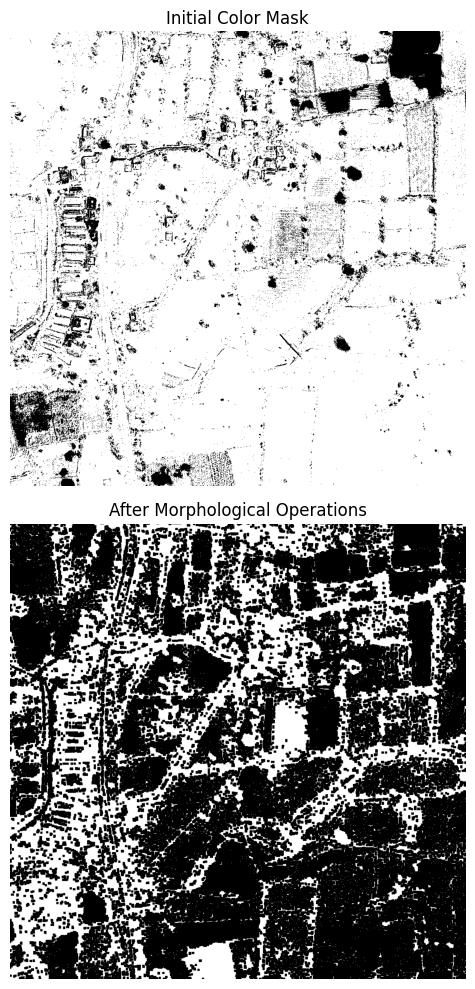

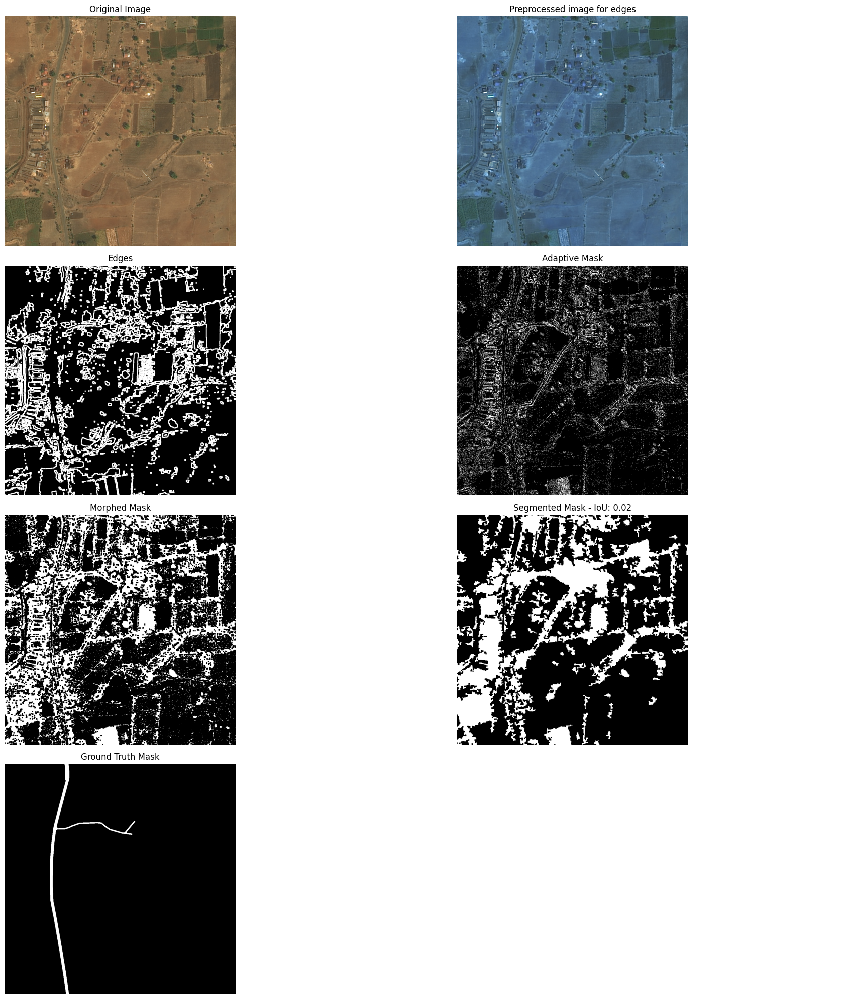

IoU: 0.017775298656626227, Precision: 0.01840390409178851, Recall: 0.3422842821339062, F1 Score: 0.03492971126355308, Accuracy: 0.6977243423461914, Total Length:(2470.6497044027524, [array([[[ 614, 1005]],

       [[ 614, 1012]],

       [[ 609, 1013]],

       [[ 609, 1019]],

       [[ 617, 1020]],

       [[ 618, 1023]],

       [[ 631, 1023]],

       [[ 631, 1021]],

       [[ 628, 1019]],

       [[ 628, 1014]],

       [[ 624, 1013]],

       [[ 624, 1008]],

       [[ 628, 1007]],

       [[ 628, 1005]],

       [[ 624, 1005]],

       [[ 623, 1008]],

       [[ 618, 1008]],

       [[ 616, 1005]]], dtype=int32), array([[[ 314, 1006]],

       [[ 314, 1014]],

       [[ 321, 1014]],

       [[ 329, 1019]],

       [[ 338, 1018]],

       [[ 339, 1023]],

       [[ 347, 1020]],

       [[ 348, 1016]],

       [[ 354, 1017]],

       [[ 352, 1023]],

       [[ 362, 1023]],

       [[ 358, 1016]],

       [[ 357, 1004]],

       [[ 353, 1004]],

       [[ 348, 1000]],

       [[ 3

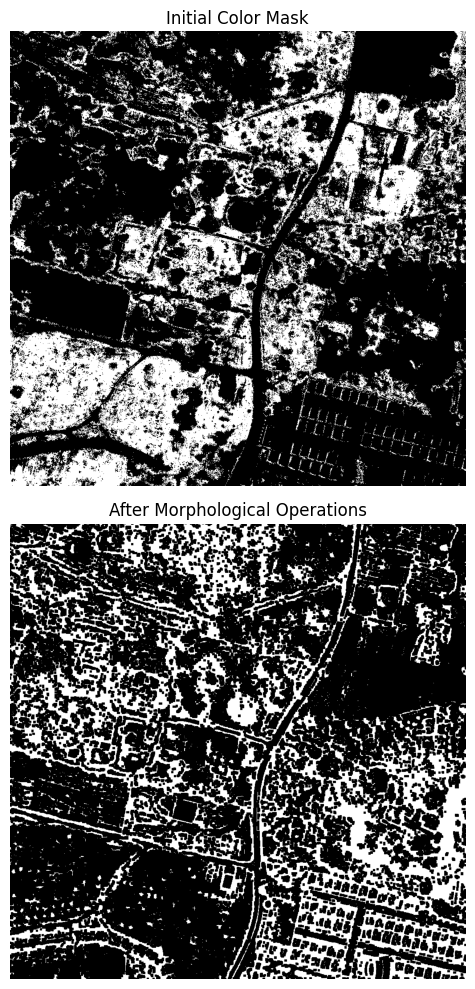

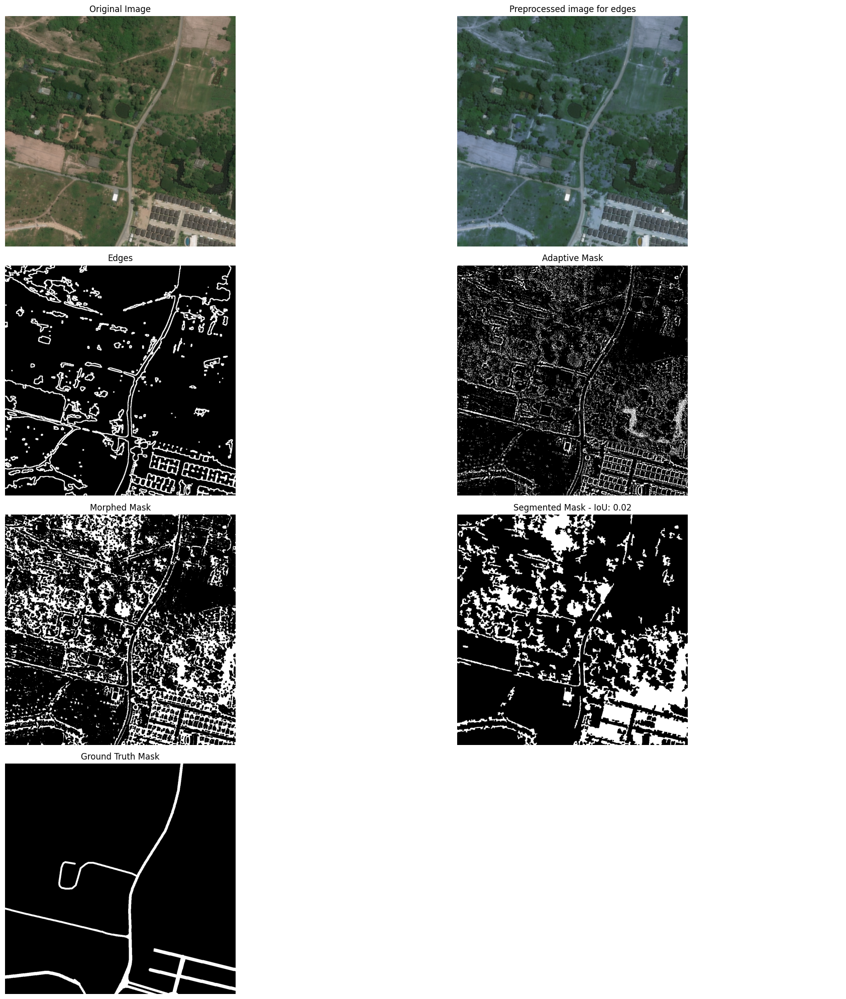

IoU: 0.016328474478254213, Precision: 0.01912541089749975, Recall: 0.10043942247332077, F1 Score: 0.03213227787726139, Accuracy: 0.7242307662963867, Total Length:(3556.5960315802704, [array([[[ 530, 1006]],

       [[ 527, 1006]],

       [[ 521, 1009]],

       [[ 521, 1011]],

       [[ 519, 1012]],

       [[ 518, 1017]],

       [[ 516, 1019]],

       [[ 516, 1023]],

       [[ 534, 1023]],

       [[ 533, 1015]],

       [[ 530, 1015]],

       [[ 529, 1019]],

       [[ 523, 1018]],

       [[ 524, 1013]],

       [[ 531, 1013]]], dtype=int32), array([[[ 639, 1007]],

       [[ 640, 1014]],

       [[ 655, 1020]],

       [[ 665, 1019]],

       [[ 666, 1023]],

       [[ 671, 1023]],

       [[ 672, 1019]],

       [[ 677, 1019]],

       [[ 678, 1023]],

       [[ 711, 1023]],

       [[ 699, 1022]],

       [[ 692, 1018]],

       [[ 684, 1019]],

       [[ 675, 1013]],

       [[ 666, 1014]],

       [[ 665, 1009]],

       [[ 642, 1004]]], dtype=int32), array([[[ 629,  999]

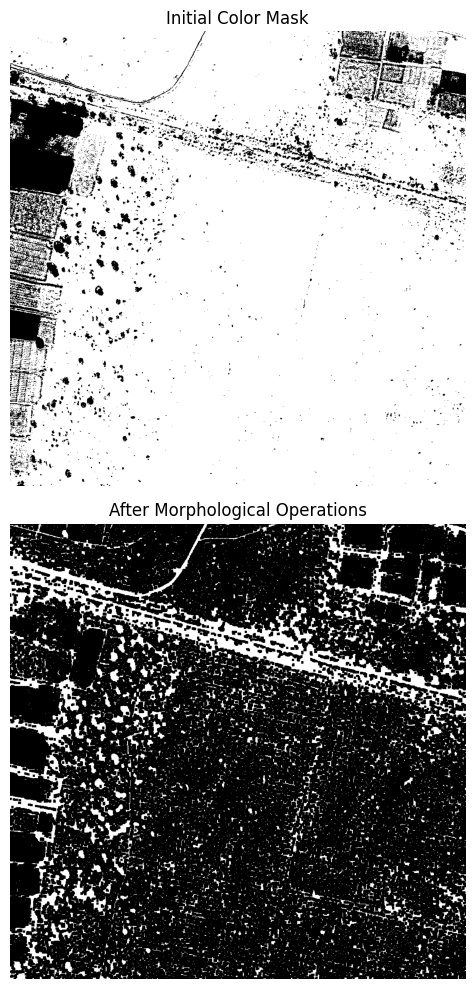

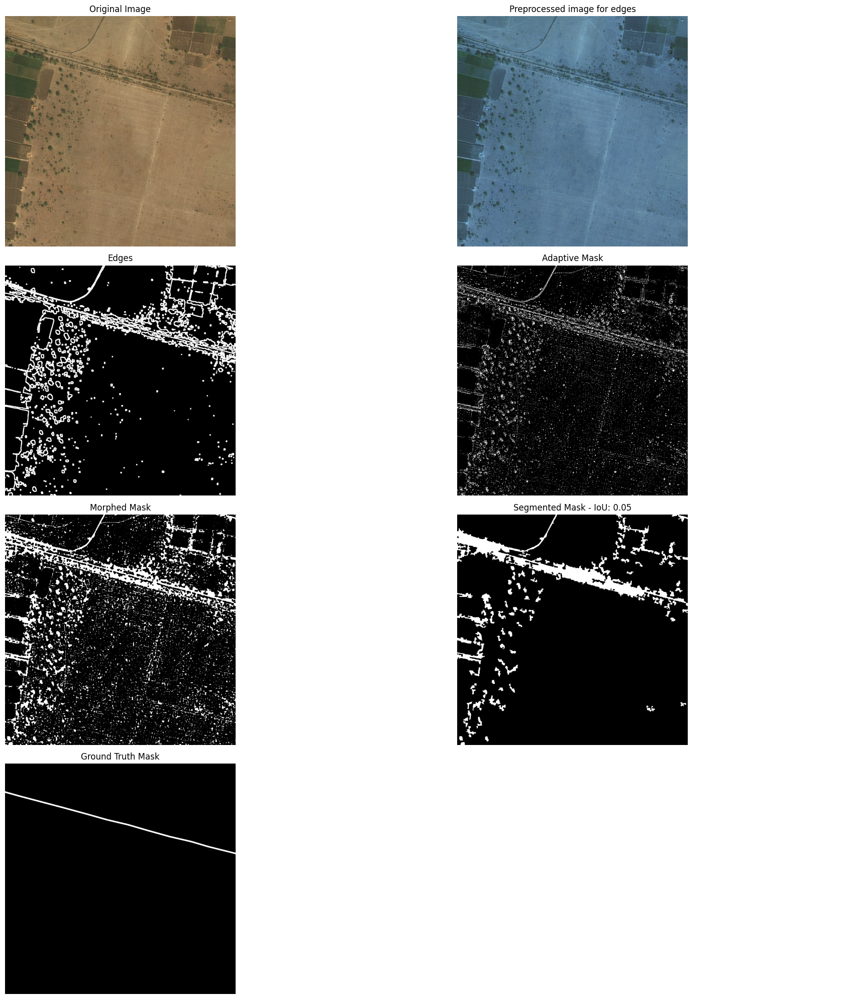

IoU: 0.05007290103551398, Precision: 0.051513658509881204, Recall: 0.6416200736397109, F1 Score: 0.0953703328333401, Accuracy: 0.9148769378662109, Total Length:(1337.3228110056307, [array([[[  32, 1011]],

       [[  19, 1012]],

       [[  19, 1014]],

       [[  18, 1015]],

       [[  16, 1015]],

       [[  16, 1021]],

       [[  14, 1022]],

       [[  14, 1023]],

       [[  33, 1023]]], dtype=int32), array([[[ 126,  986]],

       [[ 124,  989]],

       [[ 124, 1000]],

       [[ 128, 1000]],

       [[ 130, 1002]],

       [[ 130, 1005]],

       [[ 131, 1005]],

       [[ 132, 1007]],

       [[ 137, 1007]],

       [[ 137, 1005]],

       [[ 139, 1004]],

       [[ 139, 1001]],

       [[ 138, 1000]],

       [[ 138,  997]],

       [[ 135,  995]],

       [[ 134,  986]]], dtype=int32), array([[[  10,  985]],

       [[   9,  997]],

       [[  12,  999]],

       [[  12, 1003]],

       [[  24, 1003]],

       [[  25, 1002]],

       [[  25, 1000]],

       [[  23,  998]],

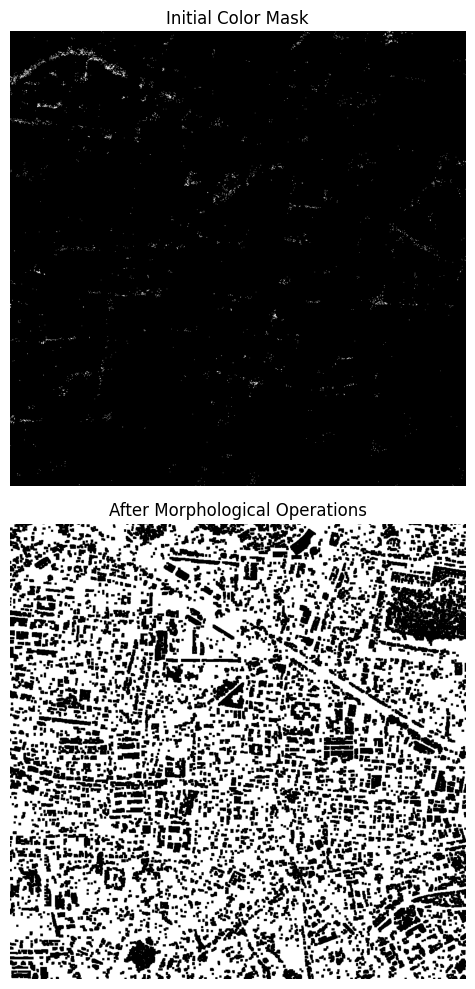

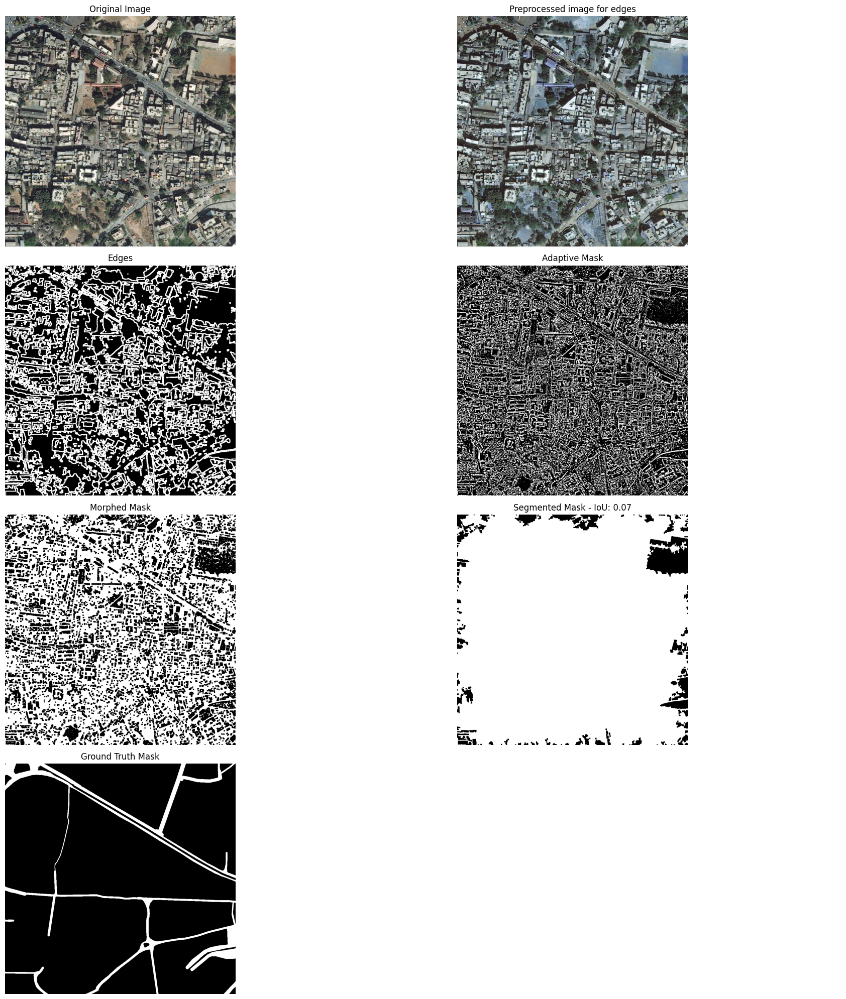

IoU: 0.07156531463091491, Precision: 0.07263820206236442, Recall: 0.8289200445826245, F1 Score: 0.13357153997759724, Accuracy: 0.12586307525634766, Total Length:(425.08077359970457, [array([[[ 997, 1012]],

       [[ 997, 1016]],

       [[1003, 1017]],

       [[1005, 1023]],

       [[1009, 1023]],

       [[1010, 1019]],

       [[1016, 1013]],

       [[1020, 1013]],

       [[1023, 1015]],

       [[1023, 1004]],

       [[1018, 1004]],

       [[1012, 1012]],

       [[1007, 1012]],

       [[1006, 1008]],

       [[1003, 1004]],

       [[1001, 1004]],

       [[1001, 1011]]], dtype=int32), array([[[1000,  574]],

       [[1000,  578]],

       [[ 997,  579]],

       [[ 997,  581]],

       [[1000,  582]],

       [[ 999,  591]],

       [[ 997,  592]],

       [[ 997,  597]],

       [[1007,  597]],

       [[1008,  584]],

       [[1002,  582]],

       [[1002,  574]]], dtype=int32), array([[[971, 128]],

       [[965, 133]],

       [[957, 133]],

       [[950, 142]],

     

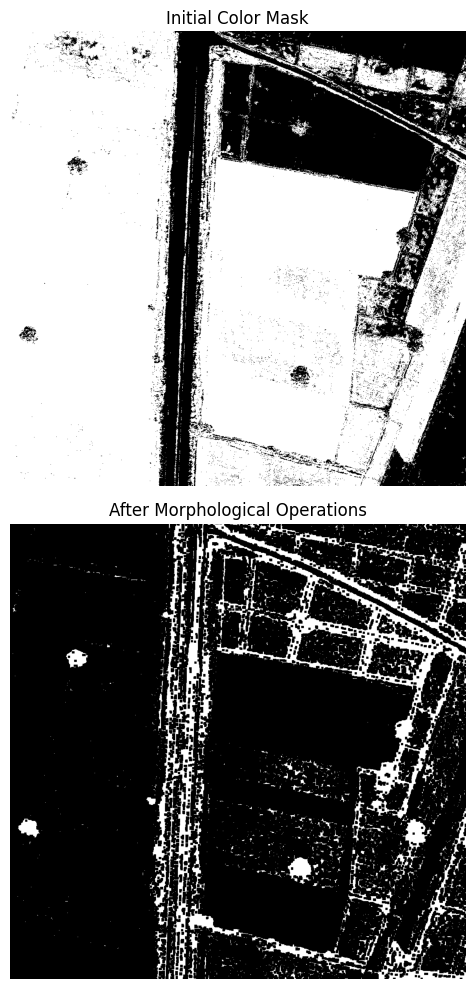

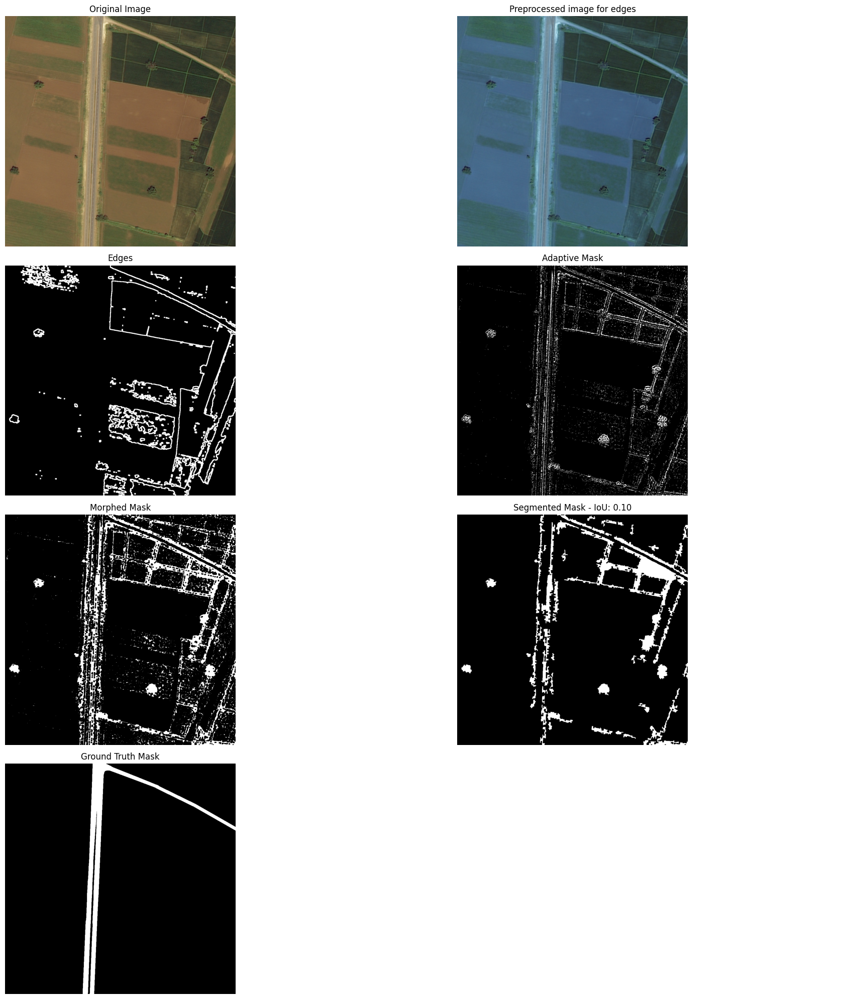

IoU: 0.0953110566983857, Precision: 0.13954212237976152, Recall: 0.23117820690636223, F1 Score: 0.174034683783223, Accuracy: 0.8823118209838867, Total Length:(1497.2431826743161, [array([[[ 851, 1022]],

       [[1023, 1023]],

       [[1023, 1009]],

       [[1019, 1016]],

       [[ 962, 1021]],

       [[ 949, 1011]],

       [[ 983, 1015]],

       [[ 983, 1009]],

       [[ 920, 1004]],

       [[ 917, 1012]],

       [[ 889, 1008]],

       [[ 893, 1016]],

       [[ 875, 1021]],

       [[ 881, 1008]],

       [[ 859, 1008]]], dtype=int32), array([[[ 848, 1001]],

       [[ 846, 1001]],

       [[ 845, 1003]],

       [[ 840, 1002]],

       [[ 834, 1003]],

       [[ 833, 1008]],

       [[ 826, 1009]],

       [[ 826, 1012]],

       [[ 828, 1013]],

       [[ 828, 1023]],

       [[ 840, 1023]],

       [[ 840, 1015]],

       [[ 844, 1011]],

       [[ 847, 1011]]], dtype=int32), array([[[739, 976]],

       [[738, 989]],

       [[741, 989]],

       [[742, 985]],

       [

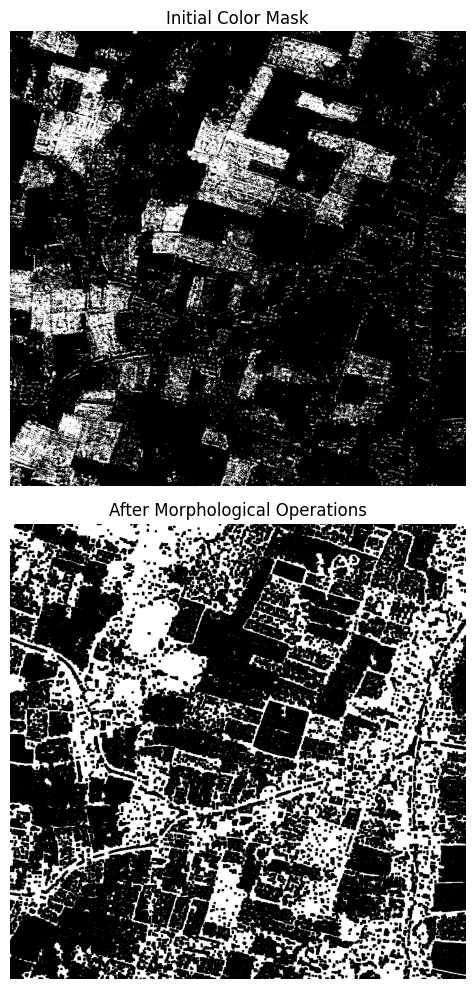

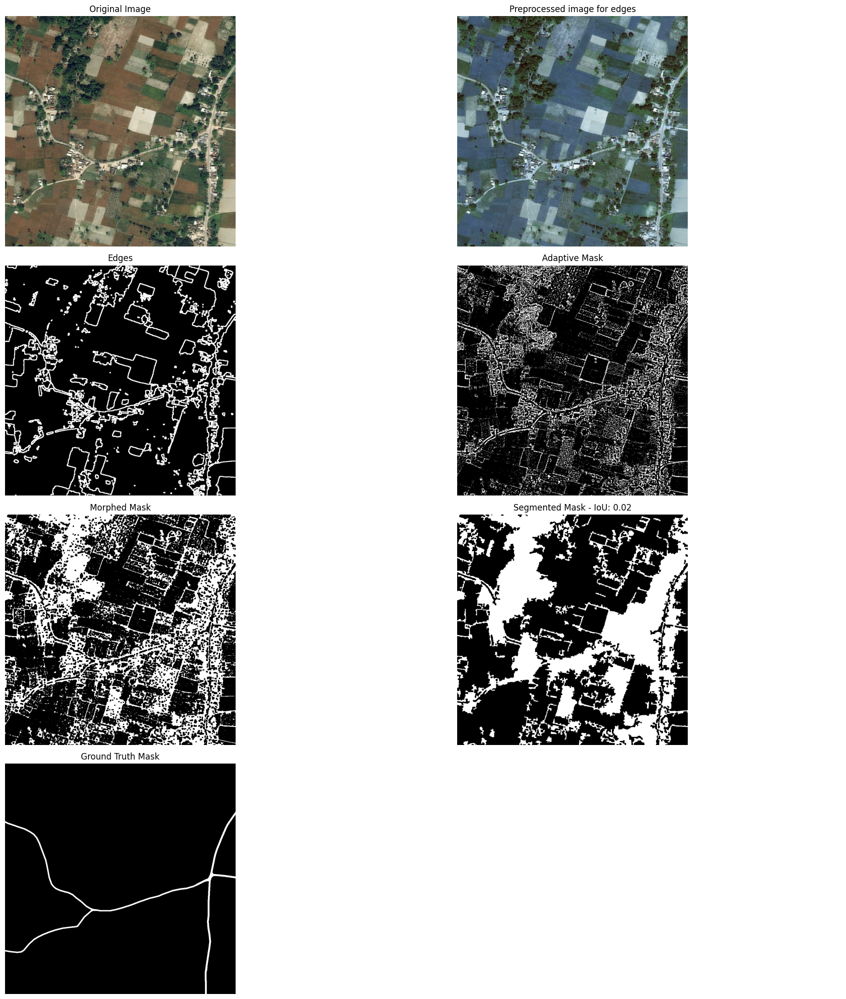

IoU: 0.02370261592453394, Precision: 0.024242840813915895, Recall: 0.5154254167568738, F1 Score: 0.04630762011510043, Accuracy: 0.6259241104125977, Total Length:(2096.6192552554376, [array([[[  27, 1014]],

       [[  31, 1023]],

       [[  63, 1023]],

       [[  64, 1019]],

       [[  74, 1020]],

       [[  75, 1023]],

       [[  86, 1023]],

       [[  80, 1022]],

       [[  79, 1016]],

       [[  73, 1015]],

       [[  59, 1016]],

       [[  57, 1019]],

       [[  45, 1022]],

       [[  47, 1006]],

       [[  32, 1009]]], dtype=int32), array([[[ 348, 1010]],

       [[ 348, 1012]],

       [[ 353, 1012]],

       [[ 356, 1015]],

       [[ 363, 1016]],

       [[ 363, 1020]],

       [[ 357, 1021]],

       [[ 357, 1023]],

       [[ 367, 1023]],

       [[ 367, 1014]],

       [[ 374, 1013]],

       [[ 374, 1010]],

       [[ 367, 1009]],

       [[ 366, 1005]],

       [[ 353, 1005]],

       [[ 352, 1009]]], dtype=int32), array([[[ 546, 1002]],

       [[ 544, 1002]]

In [66]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

# Assuming the other functions and necessary imports from torchvision, etc., are already defined

def main():
    for image_path, mask_path in zip(validate_images, validate_masks):
        original_image = cv2.imread(image_path)
        ground_truth_mask = cv2.imread(mask_path, cv2.IMREAD_GRAYSCALE)

        # Enhanced preprocessing
        preprocessed_image = preprocess_image(original_image)
        preprocessed_image_for_edges = preprocess_image_for_edges(original_image)

        # Hybrid edge detection
        edges = edge_detection(preprocessed_image_for_edges)

        # Dynamic color segmentation
        color_mask = color_segmentation(preprocessed_image)
         # Dynamic color segmentation
        adaptive_mask = adaptive_color_segmentation(preprocessed_image)

         # Apply morphological operations on the adaptive mask
        morphed_mask = apply_morphology(adaptive_mask)
        post_processed_mask = post_process(morphed_mask)
        contours = find_contours(post_processed_mask)
        road_length = calculate_road_length(contours, pixel_to_real=0.05)  # Example: 0.05 meters per pixel

        mask = create_mask(contours, preprocessed_image.shape[:2])
        # Inside your main function, at the point of visualization
        debug_visualization(
            [color_mask, morphed_mask],
            ['Initial Color Mask', 'After Morphological Operations']
        )

        # Calculate metrics
        iou_score = calculate_iou(mask, ground_truth_mask)
        precision, recall, f1 = calculate_metrics(mask, ground_truth_mask)
        accuracy = calculate_accuracy(mask, ground_truth_mask)

        # Visualization - make sure to visualize the adaptive_mask to see the results of your new segmentation
        visualize_results(
            original_image, preprocessed_image_for_edges, edges,
            adaptive_mask, morphed_mask, mask, ground_truth_mask, iou_score
        )

        # Print the evaluation metrics
        print(f"IoU: {iou_score}, Precision: {precision}, Recall: {recall}, F1 Score: {f1}, Accuracy: {accuracy}, Total Length:{road_length} meters")


# Execute the main function
main()


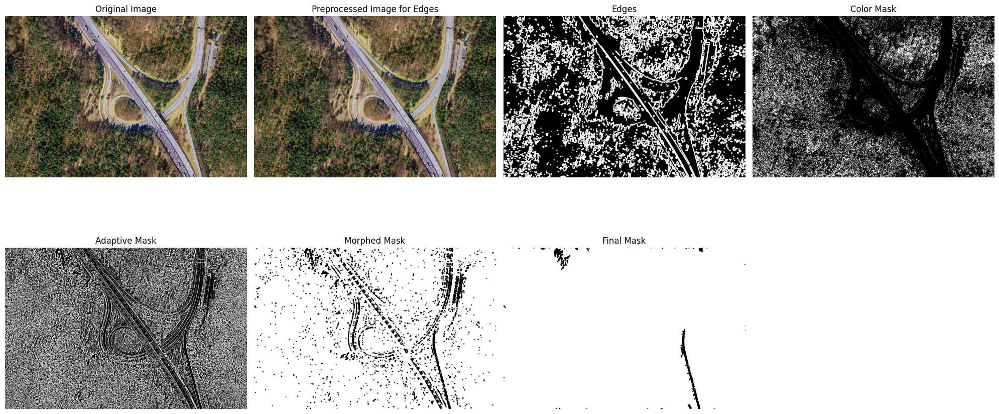

Total road length: (514.5097187707585, [array([[[   0,    0]],

       [[   0,  865]],

       [[1045,  865]],

       [[ 970,  435]],

       [[1058,  865]],

       [[1299,  865]],

       [[1299,    0]],

       [[ 290,    0]],

       [[ 313,  119]],

       [[ 280,    0]]], dtype=int32)]) meters


In [67]:
def test_single_image(image_path):
    original_image = cv2.imread(image_path)
    if original_image is None:
        print("Error: Image not found or unable to read.")
        return

    # Enhanced preprocessing
    preprocessed_image = preprocess_image(original_image)
    preprocessed_image_for_edges = preprocess_image_for_edges(original_image)

    # Hybrid edge detection
    edges = edge_detection(preprocessed_image_for_edges)

    # Dynamic color segmentation
    color_mask = color_segmentation(preprocessed_image)
    adaptive_mask = adaptive_color_segmentation(preprocessed_image)

    # Apply morphological operations on the adaptive mask
    morphed_mask = apply_morphology(adaptive_mask)
    post_processed_mask = post_process(morphed_mask)
    contours = find_contours(post_processed_mask)
    mask = create_mask(contours, preprocessed_image.shape[:2])

    # Calculate road length, assuming 0.05 meters per pixel as an example scale
    road_length = calculate_road_length(contours, pixel_to_real=0.05)

    # Visualization
    visualize_single_image_results(
        original_image, preprocessed_image_for_edges, edges, color_mask, adaptive_mask, morphed_mask, mask
    )

    # Print road length
    print(f"Total road length: {road_length} meters")

def visualize_single_image_results(original_image, preprocessed_image_for_edges, edges, color_mask, adaptive_mask, morphed_mask, mask):
    plt.figure(figsize=(20, 10))
    titles = ['Original Image', 'Preprocessed Image for Edges', 'Edges', 'Color Mask', 'Adaptive Mask', 'Morphed Mask', 'Final Mask']
    images = [original_image, preprocessed_image_for_edges, edges, color_mask, adaptive_mask, morphed_mask, mask]

    for i, (img, title) in enumerate(zip(images, titles)):
        plt.subplot(2, 4, i+1)
        if img.ndim == 2:  # Grayscale image
            plt.imshow(img, cmap='gray')
        elif img.shape[2] == 3:  # Color image
            plt.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
        plt.title(title)
        plt.axis('off')

    plt.tight_layout()
    plt.show()

# Example usage
image_path = 'images/sat.jpg'
test_single_image(image_path)

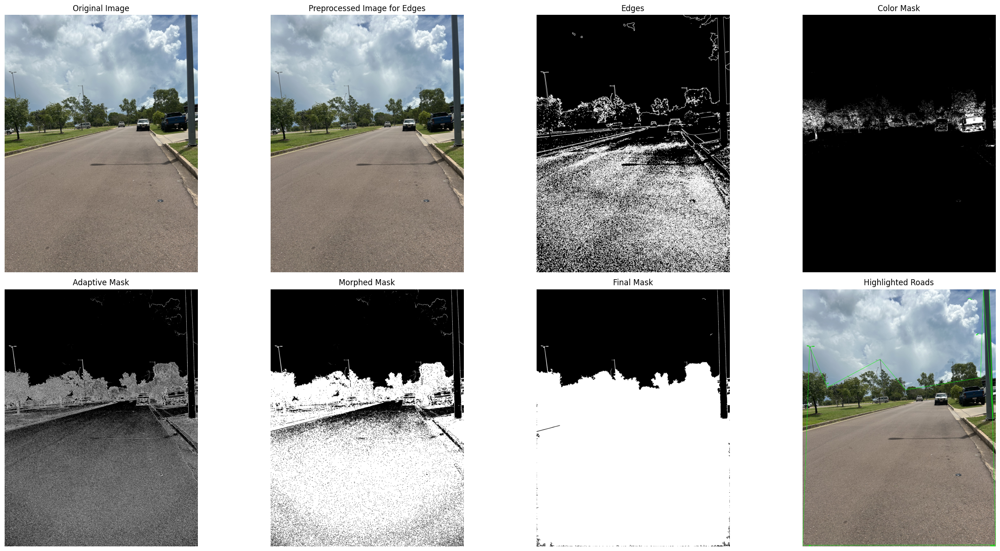

Total road length: 1583.5146424663235 meters


In [68]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

def test_single_image(image_path, pixel_to_real=0.05):
    original_image = cv2.imread(image_path)
    if original_image is None:
        print("Error: Image not found or unable to read.")
        return

    # Enhanced preprocessing
    preprocessed_image = preprocess_image(original_image)
    preprocessed_image_for_edges = preprocess_image_for_edges(original_image)

    # Hybrid edge detection
    edges = edge_detection(preprocessed_image_for_edges)

    # Dynamic color segmentation
    color_mask = color_segmentation(preprocessed_image)
    adaptive_mask = adaptive_color_segmentation(preprocessed_image)

    # Apply morphological operations on the adaptive mask
    morphed_mask = apply_morphology(adaptive_mask)
    post_processed_mask = post_process(morphed_mask)
    contours = find_contours(post_processed_mask)
    mask = create_mask(contours, preprocessed_image.shape[:2])

    # Calculate road length and get road contours for highlighting
    road_length, road_contours = calculate_road_length(contours, pixel_to_real=0.05)

    # Highlight roads on the original image
    highlighted_image = original_image.copy()
    cv2.drawContours(highlighted_image, road_contours, -1, (0, 255, 0), 3)

    # Visualization
    visualize_single_image_results(
        original_image, preprocessed_image_for_edges, edges, color_mask, adaptive_mask, morphed_mask, mask, highlighted_image
    )

    # Print road length
    print(f"Total road length: {road_length} meters")

def visualize_single_image_results(original_image, preprocessed_image_for_edges, edges, color_mask, adaptive_mask, morphed_mask, mask, highlighted_image):
    plt.figure(figsize=(24, 12))
    titles = ['Original Image', 'Preprocessed Image for Edges', 'Edges', 'Color Mask', 'Adaptive Mask', 'Morphed Mask', 'Final Mask', 'Highlighted Roads']
    images = [original_image, preprocessed_image_for_edges, edges, color_mask, adaptive_mask, morphed_mask, mask, highlighted_image]

    for i, (img, title) in enumerate(zip(images, titles)):
        plt.subplot(2, 4, i+1)
        if img.ndim == 2:  # Grayscale image
            plt.imshow(img, cmap='gray')
        elif img.shape[2] == 3:  # Color image
            plt.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
        plt.title(title)
        plt.axis('off')

    plt.tight_layout()
    plt.show()

image_path = 'images/IMG_0158.jpg'
test_single_image(image_path)